In [10]:
import json
import pandas as pd
import numpy as np

In [11]:
with open('./data/match_1.json', 'r') as json_file:
    data = json.load(json_file)
df = pd.DataFrame(data)

In [12]:
# Find the maximum length of lists in the column
max_length = max(df['norm'].apply(len))

# Pad the lists with zeros to the maximum length
df['norm'] = df['norm'].apply(lambda x: x + [0] * (max_length - len(x)))
# df['norm'] = df['norm'].apply(lambda x: x[:49])

In [13]:
df_transformed = df['norm'].apply(pd.Series)

In [14]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Encode the labels in the 'label_column' and create a new 'encoded_column'
df_transformed['label'] = label_encoder.fit_transform(df['label'])

## TimeGAN

In [15]:
# X = df_transformed.T

In [16]:
# X = np.asarray(X).astype(np.float32)

In [17]:
# # X.shape
df_transformed.shape

(574, 228)

In [18]:
import numpy as np
from helpers.model import TimeGAN

In [40]:
# Fit the model to the training data
model = TimeGAN(
    x=df_transformed.T.values,
    timesteps=19,
    hidden_dim=64,
    num_layers=3,
    lambda_param=0.1,
    eta_param=10,
    learning_rate=0.01,
    batch_size=16
)

<_TensorSliceDataset element_spec=TensorSpec(shape=(19, 574), dtype=tf.float64, name=None)>


epoch: 1 autoencoder_loss: 574.694702 generator_loss: 53.451744 discriminator_loss: 2.982287
epoch: 2 autoencoder_loss: 576.447571 generator_loss: 91.719666 discriminator_loss: 3.069577
epoch: 3 autoencoder_loss: 504.193390 generator_loss: 213.902451 discriminator_loss: 3.408599
epoch: 4 autoencoder_loss: 407.092682 generator_loss: 329.274658 discriminator_loss: 2.409386
epoch: 5 autoencoder_loss: 332.893066 generator_loss: 195.753220 discriminator_loss: 1.913667
epoch: 6 autoencoder_loss: 297.911102 generator_loss: 188.353745 discriminator_loss: 1.554979
epoch: 7 autoencoder_loss: 307.022003 generator_loss: 128.269821 discriminator_loss: 1.280633
epoch: 8 autoencoder_loss: 283.813843 generator_loss: 87.874725 discriminator_loss: 1.403703
epoch: 9 autoencoder_loss: 277.514038 generator_loss: 90.482796 discriminator_loss: 1.547654
epoch: 10 autoencoder_loss: 258.277557 generator_loss: 107.888222 discriminator_loss: 1.007529
epoch: 11 autoencoder_loss: 254.958130 generator_loss: 105.1596

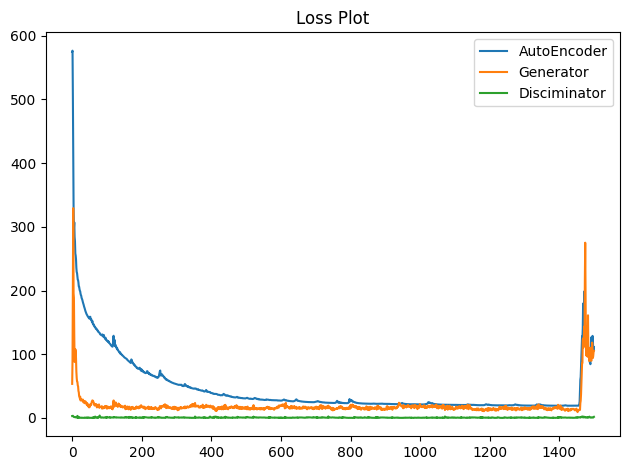

In [41]:
model.fit(
    epochs=1500,
    verbose=True
)


In [42]:
# Generate the synthetic data

x_sim = model.simulate(samples=228)

(574,)
(228, 574)
(574,)


In [43]:
x_sim

array([[-1.14759786, -0.08311385, -1.44447778, ..., -1.7593032 ,
         1.07916063, -1.19380445],
       [-0.65518755, -0.02051922, -1.1373053 , ..., -1.67222975,
         0.37932079, -1.37077981],
       [-0.63193663, -0.02388958, -1.12728031, ..., -1.68147167,
         0.29004303, -1.38470796],
       ...,
       [-2.70944617, -0.79531905, -2.72738559, ..., -2.86274129,
        -2.48811335, -2.16834077],
       [-2.75956276, -0.81565515, -2.7690443 , ..., -2.89197182,
        -2.5819409 , -2.20315655],
       [-2.73883338, -0.81082227, -2.75454594, ..., -2.88390592,
        -2.59079812, -2.20761457]])

In [44]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
def plot(actual, reconstructed, synthetic):
    '''
    Plot the actual, reconstructed and synthetic time series.
    '''
    
    fig = make_subplots(
        subplot_titles=['Actual', 'Reconstructed', 'Synthetic'],
        vertical_spacing=0.15,
        rows=3,
        cols=1
    )
    
    fig.update_layout(
        plot_bgcolor='white',
        paper_bgcolor='white',
        margin=dict(t=60, b=60, l=30, r=30),
        font=dict(
            color='#1b1f24',
            size=8,
        ),
        legend=dict(
            traceorder='normal',
            font=dict(
                color='#1b1f24',
                size=10,
            ),
            x=0,
            y=-0.1,
            orientation='h'
        ),
    )
    
    fig.update_annotations(
        font=dict(
            color='#1b1f24',
            size=12,
        )
    )
    
    # plot the actual time series
    for i in range(actual.shape[1]):
        fig.add_trace(
            go.Scatter(
                y=actual[:, i],
                showlegend=False,
                mode='lines',
                line=dict(
                    color='rgba(175,184,193,0.2)',
                    width=0.5
                )
            ),
            row=1,
            col=1
        )

    fig.add_trace(
        go.Scatter(
            y=np.mean(actual, axis=1),
            name='Actual Avg.',
            showlegend=True,
            mode='lines',
            line=dict(
                color='#0969da',
                width=1,
                shape='spline',
            )
        ),
        row=1,
        col=1
    )
    
    # plot the reconstructed time series
    for i in range(reconstructed.shape[1]):
        fig.add_trace(
            go.Scatter(
                y=reconstructed[:, i],
                showlegend=False,
                mode='lines',
                line=dict(
                    color='rgba(175,184,193,0.2)',
                    width=0.5
                )
            ),
            row=2,
            col=1
        )
    
    fig.add_trace(
        go.Scatter(
            y=np.mean(reconstructed, axis=1),
            name='Reconstructed Avg.',
            showlegend=True,
            mode='lines',
            line=dict(
                color='#0969da',
                width=1,
                shape='spline',
                dash='dash',
            )
        ),
        row=2,
        col=1
    )
    
    # plot the synthetic time series
    for i in range(synthetic.shape[1]):
        fig.add_trace(
            go.Scatter(
                y=synthetic[:, i],
                showlegend=False,
                mode='lines',
                line=dict(
                    color='rgba(175,184,193,0.2)',
                    width=0.5
                )
            ),
            row=3,
            col=1
        )
        
    fig.add_trace(
        go.Scatter(
            y=np.mean(synthetic, axis=1),
            name='Synthetic Avg.',
            showlegend=True,
            mode='lines',
            line=dict(
                color='#0969da',
                width=1,
                shape='spline',
                dash='dot',
            )
        ),
        row=3,
        col=1
    )
    
    for i in [1, 2, 3]:
        fig.update_xaxes(
            title='Time',
            color='#424a53',
            tickfont=dict(
                color='#6e7781',
                size=6,
            ),
            linecolor='#eaeef2',
            mirror=True,
            showgrid=False,
            row=i,
            col=1
        )
        
        fig.update_yaxes(
            range=[0.9 * np.min(actual), 1.1 * np.max(actual)],
            title='Value',
            color='#424a53',
            tickfont=dict(
                color='#6e7781',
                size=6,
            ),
            linecolor='#eaeef2',
            mirror=True,
            showgrid=False,
            zeroline=False,
            row=i,
            col=1
        )
    fig.show()
    return fig


In [45]:
plot(df_transformed.T.values.T, x_sim.T, x_sim.T)

In [46]:
df_sim = pd.DataFrame(x_sim)

In [47]:
df_output = pd.DataFrame()
df_output['gait'] = df_sim.apply(lambda row: row[:-1].tolist(),axis=1)
df_output['label'] = df_sim.apply(lambda row: int(row[-1:]),axis=1)

In [48]:
df_output['label_str'] = 'other'
df_output.loc[(-1 < df_output['label']) & (df_output['label'] < 8), 'label_str'] = label_encoder.inverse_transform(df_output.loc[(-1 < df_output['label']) & (df_output['label'] < 8), 'label'])

In [49]:
df_output

,gait,label,label_str
0,"[-1.147597857113639, -0.0831138543872294, -1.4...",-1,other
1,"[-0.6551875460493344, -0.02051922215439106, -1...",-1,other
2,"[-0.6319366325836784, -0.023889577890323643, -...",-1,other
3,"[-0.7816602008212188, -0.08610714673880349, -1...",-1,other
4,"[-0.7011818543927175, -0.06108519241374033, -1...",-1,other
...,...,...,...
223,"[-2.7299444764945546, -0.8031719614596655, -2....",-2,other
224,"[-2.722304471781645, -0.7985958470655428, -2.7...",-2,other
225,"[-2.7094461707210593, -0.7953190536992372, -2....",-2,other
226,"[-2.7595627586541456, -0.8156551513018941, -2....",-2,other


In [50]:
df_output['label_str'].value_counts()

other    144
cross     84
Name: label_str, dtype: int64

## Classification

In [51]:
import pandas as pd
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score

In [52]:
# Assuming the target variable is named 'target'
X = df_transformed.drop('label', axis=1)
y = df_transformed['label']
y = pd.get_dummies(df_transformed['label'], prefix='label')


# Split the data into training and validation sets (adjust test_size and random_state as needed)
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)


In [53]:

# Create an XGBoost classifier
model = XGBClassifier()

# Train the model on the training data
model.fit(X_train, y_train)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [54]:
# Make predictions on the validation set
y_pred = model.predict(X_train)

# Evaluate the model's accuracy on the validation set
accuracy = accuracy_score(y_train, y_pred)
print(f"Validation Accuracy: {accuracy}")

Validation Accuracy: 0.9978213507625272


In [55]:
# Make predictions on the validation set
y_pred = model.predict(X_valid)

# Evaluate the model's accuracy on the validation set
accuracy = accuracy_score(y_valid, y_pred)
print(f"Validation Accuracy: {accuracy}")

Validation Accuracy: 0.6434782608695652


### Infer on the generated data

In [56]:
X_sim = df_sim.T

In [57]:
X_sim.drop([227],axis=1,inplace=True)

In [58]:
# Make predictions on the validation set
y_pred = model.predict(X_sim)


In [59]:
dummy_df = pd.DataFrame(y_pred, columns=['Category_walk', 'Category_rest', 'Category_run', 'Category_tackle', 'Category_dribble', 'Category_pass', 'Category_cross', 'Category_shot'])
dummy_df['label'] = dummy_df.idxmax(axis=1).str.replace('Category_', '')

In [60]:
dummy_df['label'].value_counts()

dribble    540
walk        30
tackle       3
shot         1
Name: label, dtype: int64